In [2]:
# This entire block helps with relative imports
import glob
import os, sys
dir2 = os.path.abspath('')
dir1 = os.path.dirname(dir2)
if not dir1 in sys.path: sys.path.append(dir1)
from tempest_extremes.utils import read_tempest_csv, read_tempest_ASCII
from utils.processing import saffir_simpson
from plotting.utils import basin_bboxes

from haversine import inverse_haversine, haversine_vector, haversine

import pandas as pd
import numpy as np
import xarray as xr
import netCDF4 as nf4
import matplotlib.pyplot as plt
from matplotlib.collections import LineCollection
import matplotlib.lines as mlines
import matplotlib.colors as mcolors
import matplotlib.patheffects as pe
import seaborn as sns

import cartopy.crs as ccrs
import cartopy.feature as cfeature

In [202]:
output_folder = r"/Users/cnd5285/Library/CloudStorage/OneDrive-ThePennsylvaniaStateUniversity/Thesis_Research/github/mpas_tools/mpas_tools/datashader_tools/output_imgs"
from PIL import Image
import glob
# Create the frames
frames = []
imgs = glob.glob(os.path.join(output_folder, "*00.png"))
imgs.sort()
imgs = imgs[1:]
for i in imgs:
    new_frame = Image.open(i)
    frames.append(new_frame)
# Save into a GIF file that loops forever
duration = 150
frames[0].save(os.path.join(output_folder, f'simulated_TC{duration}.gif'), format='GIF',
               append_images=frames[1:],
               save_all=True,
               duration=duration, loop=0)
new_frame.close()

In [3]:
# block to calculate distance from miami
def miami_storms(df, distance=500.0, units='km'):

    miami_coords = (25.775163, -80.208615)
    miami_dist = distance #km
    df['miami_dist'] = df.apply(lambda x: haversine_vector((x.lat, x.lon), 
                                                                     miami_coords, unit=units, 
                                                                     normalize=True)[0], axis=1).round(2)
    df = df[df['miami_dist'].apply(lambda x: x <= miami_dist)].reset_index(drop=True)
    storms = df['tempest_ID'].unique()
    
    return storms

# method 1: filter down to tempest_IDs and select by tempest_IDs
# method 2: return full dataframe, only graph select few

In [4]:
def all_calcs(dataframe, distance=500, units='km'):
    # calculates distance from Miami
    miami_coords = (25.775163, -80.208615)
    miami_dist = distance #km
    df = dataframe.copy()
    df['miami_dist'] = df.apply(lambda x: haversine_vector((x.lat, x.lon), 
                                                                     miami_coords, unit=units, 
                                                                     normalize=True)[0], axis=1).round(2)
    
    # calculates Saffir-Simpson scale
    df['ss_wsp'] = df.apply(lambda x: saffir_simpson(x.wsp, 'm/s'), axis=1)
    
    # categorizes basin
    
    
    return df

In [5]:
tracks_folder = r"/Users/cnd5285/Library/CloudStorage/OneDrive-ThePennsylvaniaStateUniversity/DeCiampa/model_traj/"
#tracks_folder = '../tempest_extremes/model_traj'
te_track_files = glob.glob(os.path.join(tracks_folder, '*[!.csv]'), recursive=False)
te_track_files

['/Users/cnd5285/Library/CloudStorage/OneDrive-ThePennsylvaniaStateUniversity/DeCiampa/model_traj/trajectories.txt.CHEY.VR28.NATL.REF.CAM5.4CLM5.0.dtime900.002',
 '/Users/cnd5285/Library/CloudStorage/OneDrive-ThePennsylvaniaStateUniversity/DeCiampa/model_traj/trajectories.txt.CORI.VR28.NATL.EXT.CAM5.4CLM5.0.dtime900.003',
 '/Users/cnd5285/Library/CloudStorage/OneDrive-ThePennsylvaniaStateUniversity/DeCiampa/model_traj/trajectories.txt.CHEY.VR28.NATL.REF.CAM5.4CLM5.0.dtime900',
 '/Users/cnd5285/Library/CloudStorage/OneDrive-ThePennsylvaniaStateUniversity/DeCiampa/model_traj/trajectories.txt.CHEY.VR28.NATL.WAT.CAM5.4CLM5.0.dtime900',
 '/Users/cnd5285/Library/CloudStorage/OneDrive-ThePennsylvaniaStateUniversity/DeCiampa/model_traj/trajectories.txt.CHEY.VR28.NATL.WAT.CAM5.4CLM5.0.dtime900.002',
 '/Users/cnd5285/Library/CloudStorage/OneDrive-ThePennsylvaniaStateUniversity/DeCiampa/model_traj/trajectories.txt.CORI.VR28.NATL.REF.CAM5.4CLM5.0.dtime900.003',
 '/Users/cnd5285/Library/CloudStorag

In [4]:
te_track_files[0].split('/')[-1]

'trajectories.txt.CHEY.VR28.NATL.REF.CAM5.4CLM5.0.dtime900.002'

In [6]:
colnames = ['timestep', 'lon', 'lat', 'slp', 'wsp', 'sfc_phi', 'year', 'month', 'day', 'hour']
te_track_dfs = [read_tempest_ASCII(f, colnames) for f in te_track_files]
te_tracks = [all_calcs(df) for df in te_track_dfs]

In [6]:
te_track_dfs[0]

,time,lon,lat,slp,wsp,sfc_phi,tempest_ID
0,1985-01-25 00:00:00,83.116714,7.634498,98708.27,32.26449,0.000,storm_0000
1,1985-01-25 06:00:00,82.070597,7.592107,99701.32,27.35374,0.000,storm_0000
2,1985-01-25 12:00:00,82.070597,7.592107,99822.81,24.49513,0.000,storm_0000
3,1985-01-25 18:00:00,80.359140,7.493154,100234.10,18.41094,1473.759,storm_0000
4,1985-01-26 00:00:00,79.980944,6.945498,100137.90,16.64115,350.854,storm_0000
...,...,...,...,...,...,...,...
38858,2014-12-06 00:00:00,119.008239,-22.209494,99071.34,15.27198,4827.211,storm_1530
38859,2014-12-06 06:00:00,119.814654,-23.600902,99427.77,14.23425,5750.282,storm_1530
38860,2014-12-06 12:00:00,121.385520,-24.424525,99674.34,11.88024,5445.413,storm_1530
38861,2014-12-06 18:00:00,123.473148,-25.477910,99659.17,12.88766,5186.333,storm_1530


In [7]:
te_tracks[0]

,time,lon,lat,slp,wsp,sfc_phi,tempest_ID,miami_dist,ss_wsp
0,1985-01-25 00:00:00,83.116714,7.634498,98708.27,32.26449,0.000,storm_0000,15885.98,Tropical Storm
1,1985-01-25 06:00:00,82.070597,7.592107,99701.32,27.35374,0.000,storm_0000,15839.60,Tropical Storm
2,1985-01-25 12:00:00,82.070597,7.592107,99822.81,24.49513,0.000,storm_0000,15839.60,Tropical Storm
3,1985-01-25 18:00:00,80.359140,7.493154,100234.10,18.41094,1473.759,storm_0000,15761.23,Tropical Storm
4,1985-01-26 00:00:00,79.980944,6.945498,100137.90,16.64115,350.854,storm_0000,15793.88,Tropical Depression
...,...,...,...,...,...,...,...,...,...
38858,2014-12-06 00:00:00,119.008239,-22.209494,99071.34,15.27198,4827.211,storm_1530,18025.05,Tropical Depression
38859,2014-12-06 06:00:00,119.814654,-23.600902,99427.77,14.23425,5750.282,storm_1530,17979.74,Tropical Depression
38860,2014-12-06 12:00:00,121.385520,-24.424525,99674.34,11.88024,5445.413,storm_1530,17837.93,Tropical Depression
38861,2014-12-06 18:00:00,123.473148,-25.477910,99659.17,12.88766,5186.333,storm_1530,17643.83,Tropical Depression


In [14]:
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    print(te_tracks[-1][te_tracks[-1]['tempest_ID'] == 'storm_1279'])


                     time         lon        lat        slp       wsp  \
31495 2008-08-20 00:00:00  334.042696  11.920772  100536.30  21.14471   
31496 2008-08-20 06:00:00  333.989518  12.108567  100424.20  24.50334   
31497 2008-08-20 12:00:00  333.849938  12.600178  100757.50  22.22614   
31498 2008-08-20 18:00:00  333.961673  13.403509  100690.60  20.50225   
31499 2008-08-21 00:00:00  333.822484  13.894367  100955.20  21.84477   
31500 2008-08-21 06:00:00  333.128399  14.373870  100501.60  20.06835   
31501 2008-08-21 12:00:00  332.737569  14.977502  100790.50  18.24358   
31502 2008-08-21 18:00:00  332.166546  15.723043  100655.80  17.41320   
31503 2008-08-22 00:00:00  331.005090  16.244574  100818.30  19.15071   
31504 2008-08-22 06:00:00  329.474360  16.757849  100713.30  19.15201   
31505 2008-08-22 12:00:00  328.082052  17.198148  100953.30  19.48427   
31506 2008-08-22 18:00:00  326.616989  17.400077  100855.40  17.95622   
31507 2008-08-23 00:00:00  324.239605  17.808149  1

In [15]:
min_slp_1279 = te_tracks[-1][te_tracks[-1]['tempest_ID'] == 'storm_1279']['slp'].values.min()
te_tracks[-1][(te_tracks[-1]['tempest_ID'] == 'storm_1279') & (te_tracks[-1]['slp'] == min_slp_1279)]

,time,lon,lat,slp,wsp,sfc_phi,tempest_ID,miami_dist,ss_wsp
31545,2008-09-01 12:00:00,283.308311,24.886373,91920.81,70.20457,0.0,storm_1279,367.01,Category 5


In [9]:
def sshws_color(wsp, units='m/s'):
    category = saffir_simpson(wsp, units)
    
    if category == 'Tropical Depression':
        return '#5EBAFF'
    elif category == 'Tropical Storm':
        return '#00FAF4'
    elif category == 'Category 1':
        return '#FFF795'
    elif category == 'Category 2':
        return '#FFD821'
    elif category == 'Category 3':
        return '#FF8F20'
    elif category == 'Category 4':
        return '#FF6060'
    elif category == 'Category 5':
        return '#C464D9'
    

In [10]:
def geog_features(ax, basin='north atlantic zoomed', resolution='10m'):
    
    lons, lats = basin_bboxes(basin)
    ax.set_extent([lons[0], lons[1], lats[0], lats[1]], crs=ccrs.PlateCarree())
    ax.add_feature(cfeature.COASTLINE.with_scale(resolution), linewidth=0.5, edgecolor='#323232', zorder=3)
    #ax.add_feature(cfeature.BORDERS.with_scale(resolution), linewidth=0.5, edgecolor='#323232', zorder=3)
    ax.add_feature(cfeature.STATES.with_scale(resolution), linewidth=0.5, facecolor='#EBEBEB', edgecolor='#616161', zorder=2)
    ax.add_feature(cfeature.LAKES.with_scale(resolution), linewidth=0.5, facecolor='#e4f1fa', edgecolor='#616161', zorder=2)
    ax.add_feature(cfeature.OCEAN.with_scale(resolution), facecolor='#e4f1fa', edgecolor='face', zorder=1)

In [221]:
def plot_sshws_segments(ax, df, figtitle=None):
    
    proj = ccrs.PlateCarree()
    for track, track_df in df.groupby('tempest_ID'):
    
        lons = track_df['lon'].values
        lats = track_df['lat'].values
        wsps = track_df['wsp'].values
        sshws_cmap = [sshws_color(x, units='m/s') for x in wsps]

        points = np.array([lons, lats]).T.reshape(-1, 1, 2)
        segments = np.concatenate([points[:-1], points[1:]], axis=1)

        lc = LineCollection(segments, colors=sshws_cmap, zorder=10, transform=proj, 
                            lw=1.25, path_effects=[pe.Stroke(linewidth=2.0, foreground='#848484'), pe.Normal()])
        ax.add_collection(lc)
    
    lw = 2.0
    lw_e = 3.0
    td = mlines.Line2D([], [], ls='-', lw=lw, label='Tropical Depression', color=sshws_color(35, 'mph'),
                       path_effects=[pe.Stroke(linewidth=lw_e, foreground='#848484'), pe.Normal()])
    ts = mlines.Line2D([], [], ls='-', lw=lw, label='Tropical Storm', color=sshws_color(50, 'mph'), 
                       path_effects=[pe.Stroke(linewidth=lw_e, foreground='#848484'), pe.Normal()])
    c1 = mlines.Line2D([], [], ls='-', lw=lw, label='Category 1', color=sshws_color(75, 'mph'), 
                       path_effects=[pe.Stroke(linewidth=lw_e, foreground='#848484'), pe.Normal()])
    c2 = mlines.Line2D([], [], ls='-', lw=lw, label='Category 2', color=sshws_color(100, 'mph'), 
                       path_effects=[pe.Stroke(linewidth=lw_e, foreground='#848484'), pe.Normal()])
    c3 = mlines.Line2D([], [], ls='-', lw=lw, label='Category 3', color=sshws_color(115, 'mph'), 
                       path_effects=[pe.Stroke(linewidth=lw_e, foreground='#848484'), pe.Normal()])
    c4 = mlines.Line2D([], [], ls='-', lw=lw, label='Category 4', color=sshws_color(135, 'mph'), 
                       path_effects=[pe.Stroke(linewidth=lw_e, foreground='#848484'), pe.Normal()])
    c5 = mlines.Line2D([], [], ls='-', lw=lw, label='Category 5', color=sshws_color(160, 'mph'), 
                       path_effects=[pe.Stroke(linewidth=lw_e, foreground='#848484'), pe.Normal()])

    l = ax.legend(handles = [c5, c4, c3, c2, c1, ts, td], loc='upper right', fontsize=14, shadow=True)
    l.set_zorder(1001)
    plt.title(figtitle, fontsize=20)
    plt.show()

In [176]:
def plot_sshws_points(ax, df, figtitle=None, j=None, label_tracks=False):
    
    proj = ccrs.PlateCarree()
    for i, (track_ID, track_df) in enumerate(df.groupby('tempest_ID')):
        track_df = track_df.sort_values(by=['tempest_ID', 'time']).reset_index(drop=True)
        lons = track_df['lon'].values
        lats = track_df['lat'].values
        wsps = track_df['wsp'].values
        sshws_cmap = [sshws_color(x, units='m/s') for x in wsps]
        
        if j == 0:
            label_pos = [[lons[8]+1.25, lats[8]+0.2], [lons[13]+1.25, lats[13]+0.2], [lons[10]-1.25, lats[10]-0.2]]
        elif j == 1:
            label_pos = [[lons[13]-1.25, lats[13]+0.2], [lons[6]-1.25, lats[6]+0.2], [lons[8]-1.25, lats[8]-0.2], [lons[3]+1.25, lats[3]+0.2]]
        elif j == 2:
            label_pos = [[lons[13]-1.25, lats[13]-0.2], [lons[11]+1.25, lats[11]+0.2], [lons[-9]-1.25, lats[-9]-0.2], [lons[8]+1.25, lats[8]+0.2]]
        elif j == 3:
            label_pos = []
        elif j == 4:
            label_pos = [[lons[14]-1.25, lats[14]+0.2], [lons[17]+1.25, lats[17]+0.35], [lons[-10]-1.1, lats[-10]-0.35]]
        elif j == 5:
            label_pos = [[lons[11]+1.25, lats[11]+0.2]]
        elif j == 6:
            label_pos = []
        elif j == 7:
            label_pos = [[lons[4]+1.25, lats[4]+0.2], [lons[0]-1.25, lats[0]-0.2]]
        elif j == 8:
            label_pos = [[lons[10]-1.25, lats[10]+0.2], [lons[14]-1.25, lats[14]-0.2]]

        points = np.array([lons, lats]).T.reshape(-1, 1, 2)
        segments = np.concatenate([points[:-1], points[1:]], axis=1)

        lc = LineCollection(segments, colors='k', zorder=9, transform=proj, lw=0.5, ls='--')
        ax.add_collection(lc)
        ax.scatter(lons, lats, c=sshws_cmap, zorder=10, edgecolors='k', lw=0.35, s=30)
        # This labels individual tracks within model runs
        if label_tracks == True:
            ax.text(label_pos[i][0], label_pos[i][1], track_ID, transform=proj, fontsize=7.5, 
                    path_effects=[pe.Stroke(linewidth=1.75, foreground='w'), pe.Normal()], clip_on=True, ha='center', va='center')
    
    # Marker properties
    mew = 0.25     # marker edge width
    mec = 'k'      # marker edge color
    ms = 6         # marker size
    #mfc           # marker face color
    
    td = mlines.Line2D([], [], marker='o', ms=ms, mew=mew, mec=mec, label='Tropical Depression', mfc=sshws_color(35, 'mph'), color='k', lw=0.5, ls='--')
    ts = mlines.Line2D([], [], marker='o', ms=ms, mew=mew, mec=mec, label='Tropical Storm', mfc=sshws_color(50, 'mph'), color='k', lw=0.5, ls='--')
    c1 = mlines.Line2D([], [], marker='o', ms=ms, mew=mew, mec=mec, label='Category 1', mfc=sshws_color(75, 'mph'), color='k', lw=0.5, ls='--')
    c2 = mlines.Line2D([], [], marker='o', ms=ms, mew=mew, mec=mec, label='Category 2', mfc=sshws_color(100, 'mph'), color='k', lw=0.5, ls='--')
    c3 = mlines.Line2D([], [], marker='o', ms=ms, mew=mew, mec=mec, label='Category 3', mfc=sshws_color(115, 'mph'), color='k', lw=0.5, ls='--')
    c4 = mlines.Line2D([], [], marker='o', ms=ms, mew=mew, mec=mec, label='Category 4', mfc=sshws_color(135, 'mph'), color='k', lw=0.5, ls='--')
    c5 = mlines.Line2D([], [], marker='o', ms=ms, mew=mew, mec=mec, label='Category 5', mfc=sshws_color(160, 'mph'), color='k', lw=0.5, ls='--')

    l = ax.legend(handles = [c5, c4, c3, c2, c1, ts, td], loc='upper right', 
                  fontsize=10, shadow=False)
    l.set_zorder(1001)
    plt.title(figtitle)
    #plt.show()

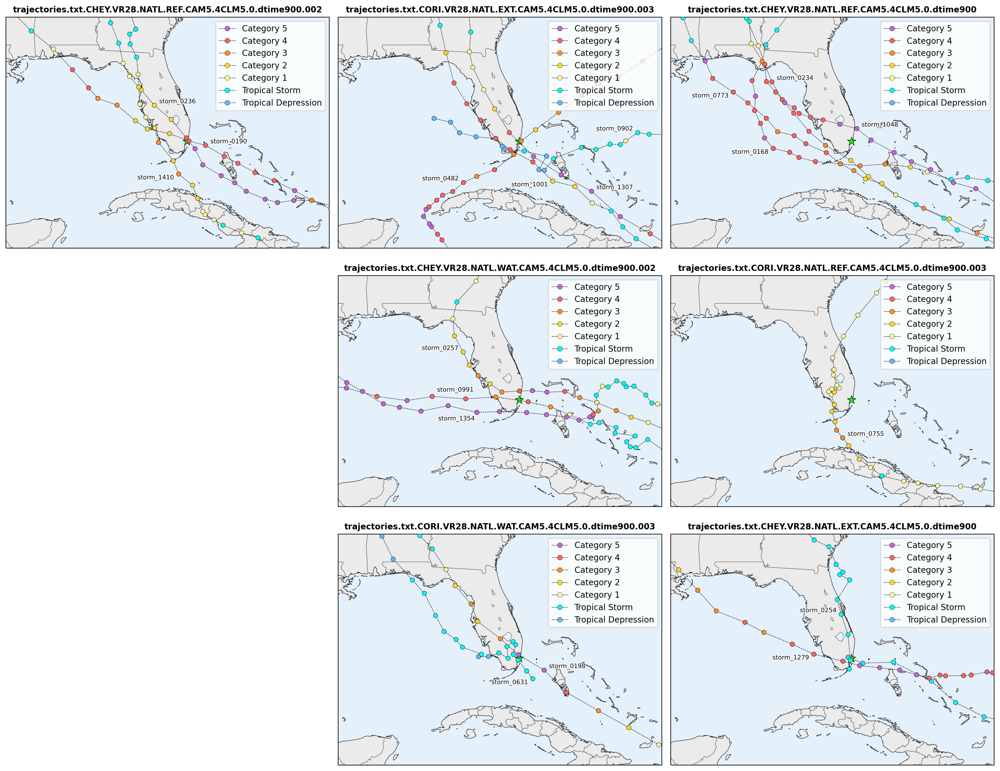

In [178]:
miami_coords = (25.775163, -80.208615)
florida_bbox = basin_bboxes('florida')

proj = ccrs.PlateCarree()
fig, axs = plt.subplots(3, 3, figsize=(17, 17), dpi=200, subplot_kw=dict(projection=proj))


for i, ax in enumerate(axs.ravel()):
    try:
        subset_df = te_tracks[i][(te_tracks[i].lon >= florida_bbox[0][0]-1.0) & (te_tracks[i].lon <= florida_bbox[0][1]+2.0) &\
                                 (te_tracks[i].lat >= florida_bbox[1][0]-1.0) & (te_tracks[i].lat <= florida_bbox[1][1]+2.0) &\
                                 (te_tracks[i]['tempest_ID'].isin(selected_tracks[i]))]
    except:
        continue
    title = te_track_files[i].split('/')[-1]
    geog_features(ax, basin='florida')
    plot_sshws_points(ax, subset_df, j=i, label_tracks=True)
    ax.set_title(label=title, fontsize=10, fontweight='bold')
    ax.scatter(x=miami_coords[1]+360, y=miami_coords[0], zorder=8, marker='*', c='#00FF00', s=120, edgecolors='k', lw=0.5, transform=proj)

fig.tight_layout(h_pad=-20.0)
#fig.suptitle('TempestExtremes Miami Tracks (Selected)')
fig.delaxes(axs[1][0])
fig.delaxes(axs[2][0])

plt.show()
# fig.savefig('../figs/te_plots/all_runs_selected.png', facecolor='w', transparent=False, bbox_inches='tight')
# fig.savefig('/Users/cnd5285/Library/CloudStorage/OneDrive-ThePennsylvaniaStateUniversity/DeCiampa/model_traj/figs/all_runs_selected.png', 
#             facecolor='w', transparent=False, bbox_inches='tight')

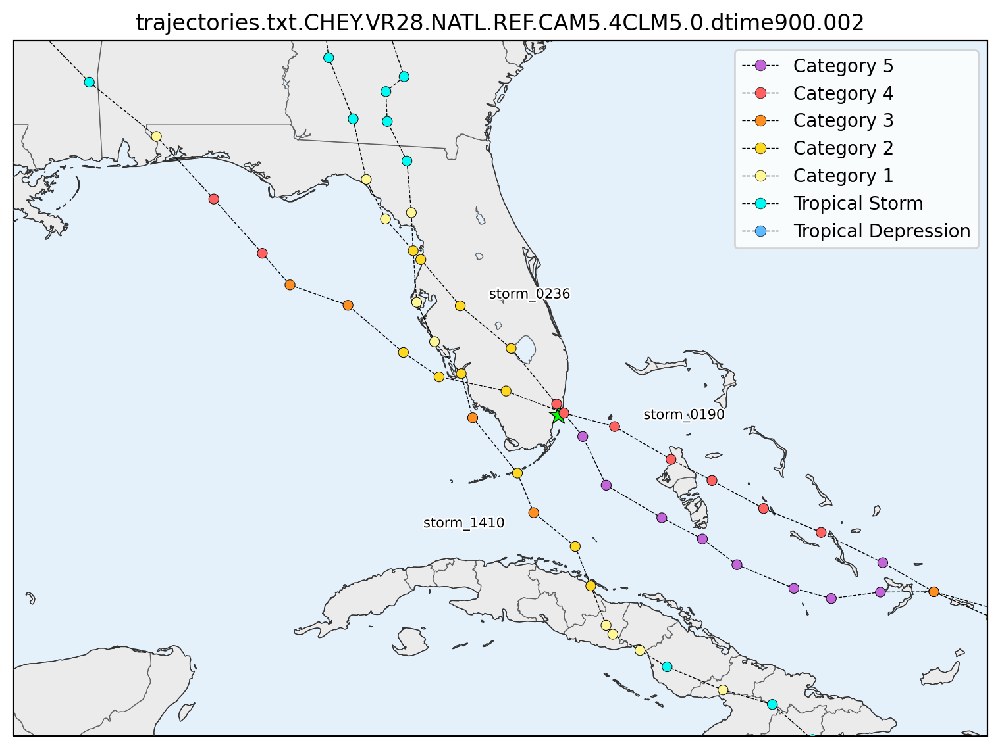

In [229]:
selected_tracks = [['storm_0190', 'storm_0236', 'storm_1410'],
           ['storm_0482', 'storm_0902', 'storm_1001', 'storm_1307'], 
           ['storm_0168', 'storm_0234', 'storm_0773', 'storm_1048'], None, 
           ['storm_0257', 'storm_0991', 'storm_1354'], 
           ['storm_0755'], None, 
           ['storm_0198', 'storm_0631'], 
           ['storm_0254', 'storm_1279']]

i=0
subset_df = te_tracks[i][(te_tracks[i].lon >= florida_bbox[0][0]-1.0) & (te_tracks[i].lon <= florida_bbox[0][1]+2.0) &\
                         (te_tracks[i].lat >= florida_bbox[1][0]-1.0) & (te_tracks[i].lat <= florida_bbox[1][1]+2.0) &\
                         (te_tracks[i]['tempest_ID'].isin(selected_tracks[i]))]
#title = 'TempestExtremes Miami Tracks (Selected)'
title = te_track_files[i].split('/')[-1]
miami_coords = (25.775163, -80.208615)

proj = ccrs.PlateCarree()
fig, ax = plt.subplots(figsize=(12,7), dpi=200, subplot_kw=dict(projection=proj))
geog_features(ax, basin='florida')
plot_sshws_points(ax, subset_df, title, label_tracks=True, j=i)
ax.scatter(x=miami_coords[1]+360, y=miami_coords[0], zorder=8, marker='*', c='#00FF00', s=120, edgecolors='k', lw=0.5, transform=proj)
plt.show()

In [24]:
selected_tracks = [['storm_0190', 'storm_0236', 'storm_1410'],
           ['storm_0482', 'storm_0902', 'storm_1001', 'storm_1307'], 
           ['storm_0168', 'storm_0234', 'storm_0773', 'storm_1048'], [], 
           ['storm_0257', 'storm_0991', 'storm_1354'], 
           ['storm_0755'], [], 
           ['storm_0198', 'storm_0631'], 
           ['storm_0254', 'storm_1279']]

selected_dfs = [te_tracks[i][te_tracks[i]['tempest_ID'].isin(sel_track)].reset_index(drop=True) for i, sel_track in enumerate(selected_tracks)]
for i, track_df in enumerate(selected_dfs):
    if not track_df.empty:
        track_df.to_csv(os.path.join(tracks_folder, te_track_files[i].split('/')[-1]+'_selectedtracks.csv'), index=False)

In [144]:
florida_bbox = basin_bboxes('florida')
florida_bbox[1]

(20.0, 32.5)

In [150]:
florida_bbox[1][0]-1.0

19.0

In [154]:
te_tracks[0]

,time,lon,lat,slp,wsp,sfc_phi,tempest_ID,miami_dist,ss_wsp
0,1985-01-25 00:00:00,83.116714,7.634498,98708.27,32.26449,0.000,storm_0,15885.98,Tropical Storm
1,1985-01-25 06:00:00,82.070597,7.592107,99701.32,27.35374,0.000,storm_0,15839.60,Tropical Storm
2,1985-01-25 12:00:00,82.070597,7.592107,99822.81,24.49513,0.000,storm_0,15839.60,Tropical Storm
3,1985-01-25 18:00:00,80.359140,7.493154,100234.10,18.41094,1473.759,storm_0,15761.23,Tropical Storm
4,1985-01-26 00:00:00,79.980944,6.945498,100137.90,16.64115,350.854,storm_0,15793.88,Tropical Depression
...,...,...,...,...,...,...,...,...,...
38858,2014-12-06 00:00:00,119.008239,-22.209494,99071.34,15.27198,4827.211,storm_1530,18025.05,Tropical Depression
38859,2014-12-06 06:00:00,119.814654,-23.600902,99427.77,14.23425,5750.282,storm_1530,17979.74,Tropical Depression
38860,2014-12-06 12:00:00,121.385520,-24.424525,99674.34,11.88024,5445.413,storm_1530,17837.93,Tropical Depression
38861,2014-12-06 18:00:00,123.473148,-25.477910,99659.17,12.88766,5186.333,storm_1530,17643.83,Tropical Depression


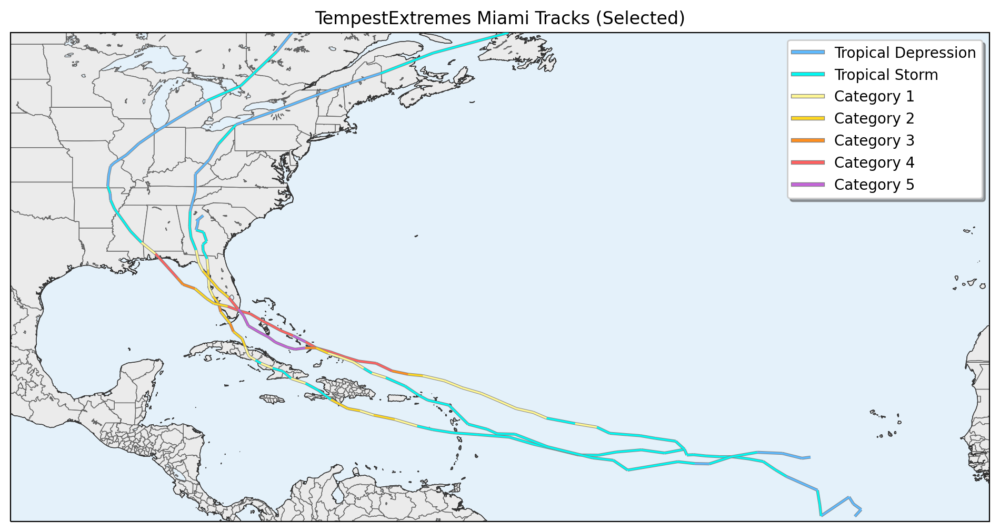

In [108]:
selected_tracks = [['storm_190', 'storm_236', 'storm_1410'],
           ['storm_482', 'storm_902', 'storm_1001', 'storm_1307'], 
           ['storm_168', 'storm_234', 'storm_773', 'storm_1048'], None, 
           ['storm_257', 'storm_991', 'storm_1354'], 
           ['storm_755'], None, 
           ['storm_198', 'storm_631'], 
           ['storm_254', 'storm_1279']]

i=0
subset_df = te_tracks[i][te_tracks[i]['tempest_ID'].isin(selected_tracks[i])]
title = 'TempestExtremes Miami Tracks (Selected)'

proj = ccrs.PlateCarree()
fig, ax = plt.subplots(figsize=(12,7), dpi=200, subplot_kw=dict(projection=proj))
geog_features(ax)
plot_sshws_segments(ax, subset_df, title)

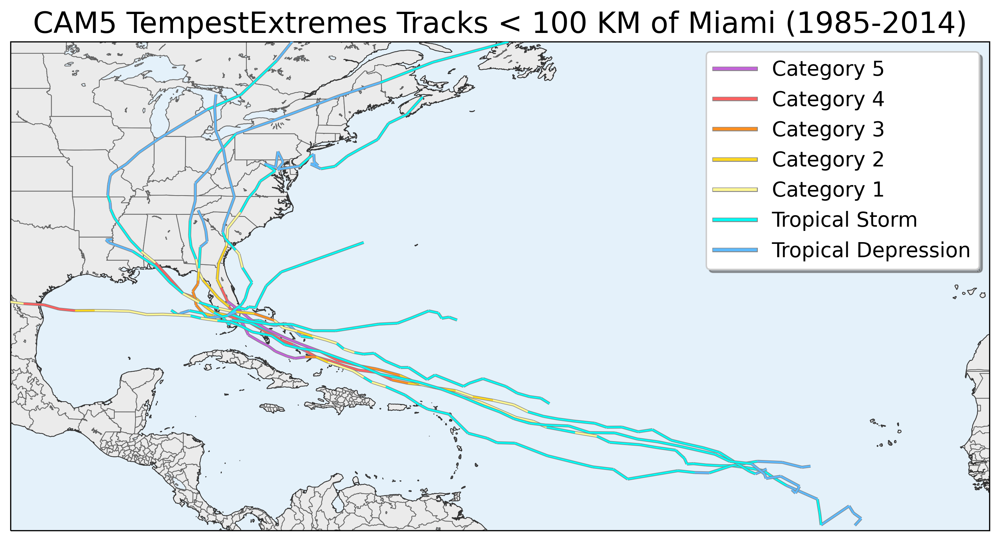

In [224]:
miami_tracks = te_tracks[0][te_tracks[0]['miami_dist'] <= 100].tempest_ID.unique()
subset_df = te_tracks[0][te_tracks[0]['tempest_ID'].isin(miami_tracks)]
title = 'CAM5 TempestExtremes Tracks < 100 KM of Miami (1985-2014)'

proj = ccrs.PlateCarree()
fig, ax = plt.subplots(figsize=(12,7), dpi=300, subplot_kw=dict(projection=proj))
geog_features(ax)
plot_sshws_segments(ax, subset_df, title)
fig.savefig('../figs/te_plots/te_miami_tracks.png', facecolor='w', transparent=False, bbox_inches='tight')

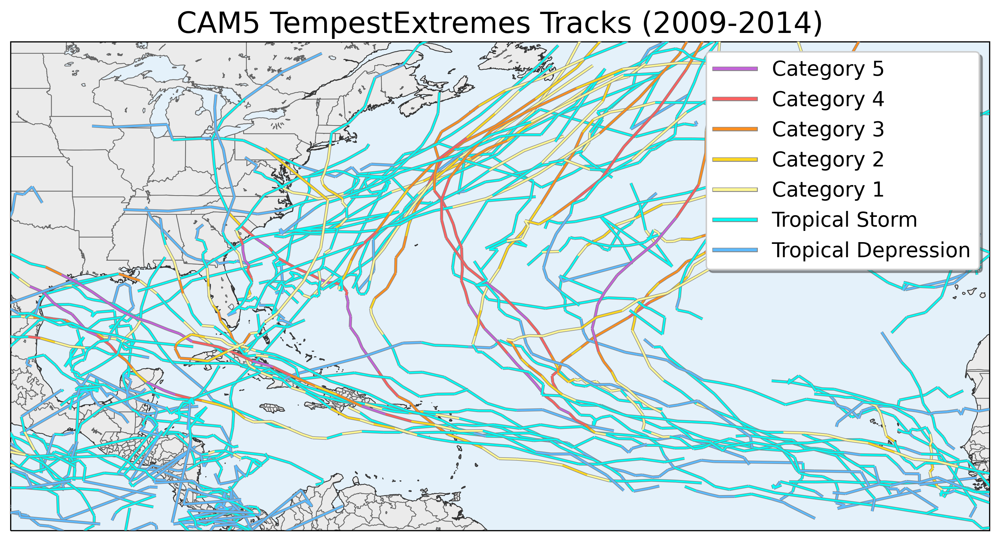

In [226]:
subset_df = te_tracks[0][te_tracks[0].time.dt.year >= 2009]
title = 'CAM5 TempestExtremes Tracks (2009-2014)'

proj = ccrs.PlateCarree()
fig, ax = plt.subplots(figsize=(12,7), dpi=300, subplot_kw=dict(projection=proj))
geog_features(ax)
plot_sshws_segments(ax, subset_df, title)
fig.savefig('../figs/te_plots/te_spaghetti.png', facecolor='w', transparent=False, bbox_inches='tight')

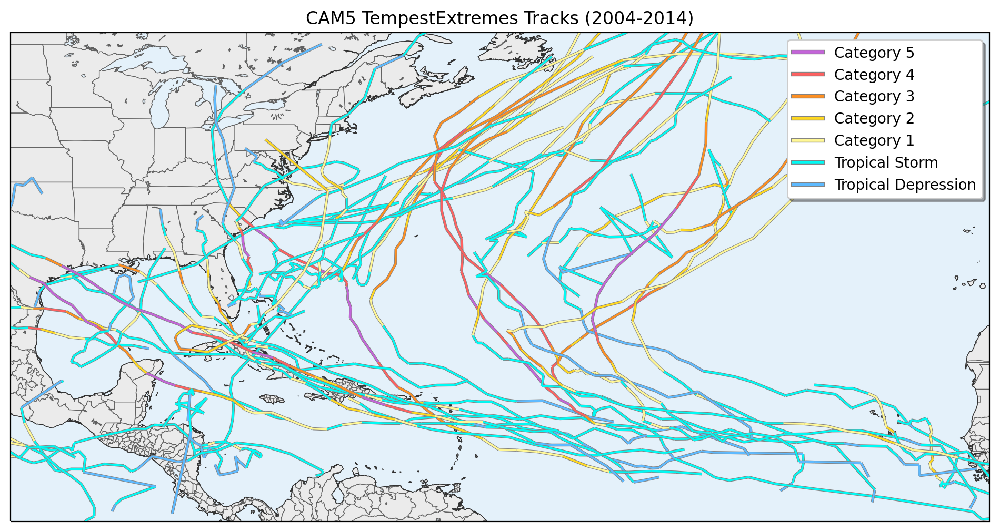

In [102]:
def omit_TD_TS(df):
    omit_tracks = []
    for track, track_df in df.groupby('tempest_ID'):
        if (track_df['ss_wsp'].isin(['Tropical Depression', 'Tropical Storm'])).all():
            omit_tracks.append(track)
    return df[~df['tempest_ID'].isin(omit_tracks)]

subset_df = te_tracks[0][te_tracks[0].time.dt.year >= 2009]
subsubset_df = omit_TD_TS(subset_df)
title = 'CAM5 TempestExtremes Tracks (2004-2014)' # Only TD and/or TS tracks omitted

proj = ccrs.PlateCarree()
fig, ax = plt.subplots(figsize=(12,7), dpi=200, subplot_kw=dict(projection=proj))
geog_features(ax)
plot_sshws_segments(ax, subsubset_df, title)

In [514]:
len(omit_tracks)

223

In [508]:
subsubset_df

,time,lon,lat,slp,wsp,sfc_phi,tempest_ID,miami_dist,ss_wsp
31250,2009-01-03 12:00:00,122.480571,-14.728229,99102.46,22.90535,0.000,storm_1220,17354.68,Tropical Storm
31251,2009-01-03 18:00:00,122.561417,-16.291689,99040.74,13.01710,0.000,storm_1220,17432.73,Tropical Depression
31252,2009-01-04 00:00:00,120.962653,-17.331234,99026.79,17.09222,0.000,storm_1220,17637.01,Tropical Storm
31253,2009-01-04 06:00:00,119.511955,-18.080625,98747.47,20.06297,0.000,storm_1220,17811.72,Tropical Storm
31254,2009-01-04 12:00:00,118.292375,-17.409021,98729.15,24.09496,0.000,storm_1220,17891.32,Tropical Storm
...,...,...,...,...,...,...,...,...,...
32597,2009-12-28 00:00:00,117.046671,-23.646565,99436.15,11.71422,2982.442,storm_1271,18257.42,Tropical Depression
32598,2009-12-28 06:00:00,117.355397,-24.784732,99244.39,15.59976,5997.631,storm_1271,18246.99,Tropical Depression
32599,2009-12-28 12:00:00,119.405296,-25.894086,99543.25,15.81934,5768.280,storm_1271,18053.91,Tropical Depression
32600,2009-12-28 18:00:00,120.655917,-25.591143,99530.71,15.57459,5774.906,storm_1271,17926.38,Tropical Depression


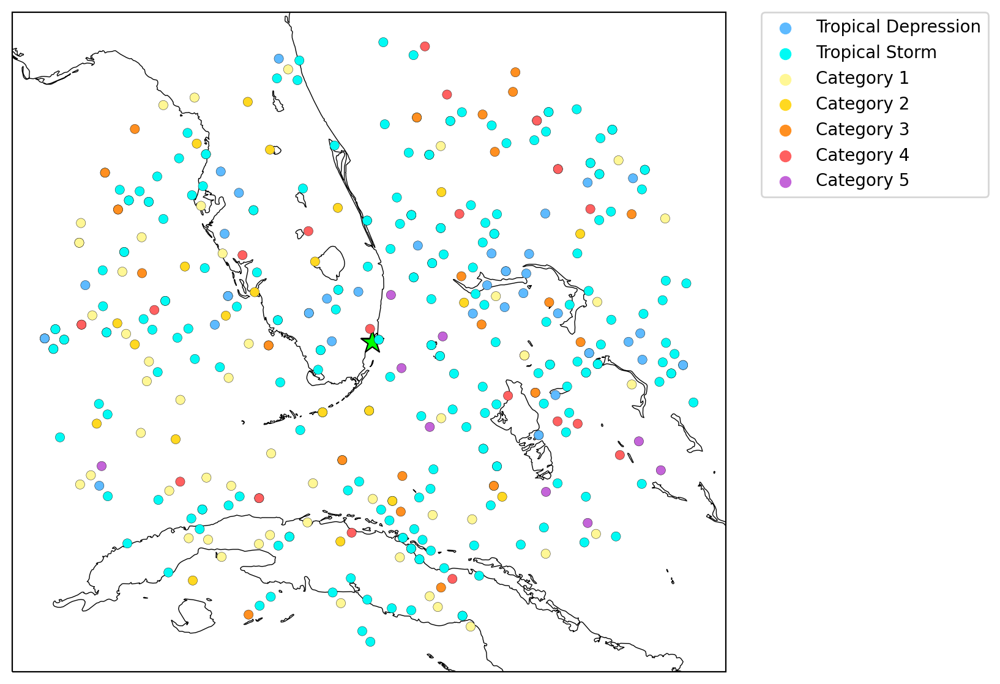

In [81]:
proj=ccrs.PlateCarree(globe=None)
fig, ax = plt.subplots(figsize=(12,7), dpi=200, subplot_kw=dict(projection=proj))
ax.add_feature(cfeature.COASTLINE.with_scale('10m'), linewidth=0.5, zorder=1)
ax.add_feature(cfeature.LAKES.with_scale('10m'), linewidth=0.5, facecolor='w', edgecolor='#616161', zorder=1)

explicit_cmap = {'Tropical Depression': '#5EBAFF', 
                 'Tropical Storm': '#00FAF4', 
                 'Category 1': '#FFF795', 
                 'Category 2': '#FFD821', 
                 'Category 3': '#FF8F20', 
                 'Category 4': '#FF6060', 
                 'Category 5': '#C464D9'}

g1 = sns.scatterplot(x='lon', y='lat', data=te_tracks[0][te_tracks[0]['miami_dist'] <= 500.0], edgecolor='black', linewidth=0.15, s=30,
                hue='ss_wsp', hue_order=color_order, palette=sns.color_palette(cat_colors), transform=proj, ax=ax, zorder=10)
h,l = g1.get_legend_handles_labels()
plt.legend(h[0:8],l[0:13],bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
g2 = plt.scatter(x=-80.208615, y=25.775163, marker='*', c='#00FF00', s=200, zorder=2, edgecolor='black', linewidth=0.75)
plt.show()

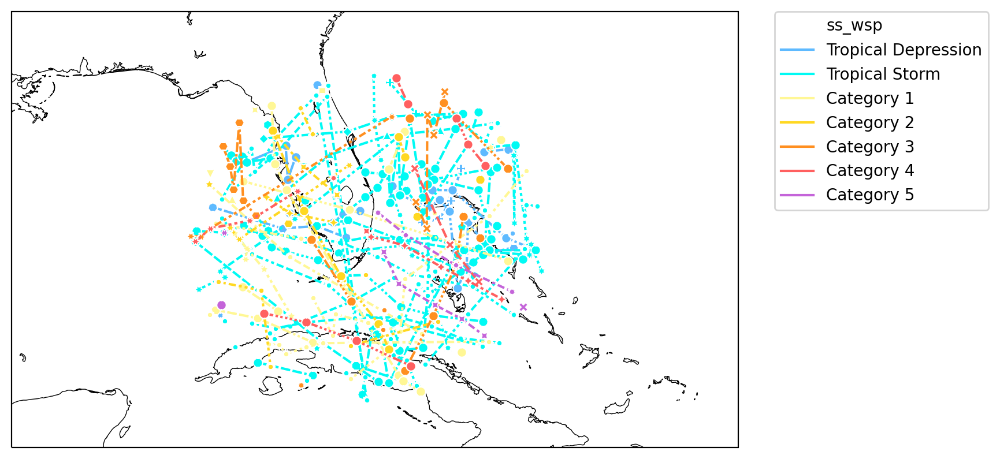

In [57]:
proj=ccrs.PlateCarree(globe=None)
fig, ax = plt.subplots(figsize=(10,5), dpi=200, subplot_kw=dict(projection=proj))

ax.set_extent([270., 290., 20., 32])
ax.add_feature(cfeature.COASTLINE.with_scale('10m'), linewidth=0.5, zorder=1)
ax.add_feature(cfeature.LAKES.with_scale('10m'), linewidth=0.5, facecolor='w', edgecolor='black', zorder=1)
#ax.add_feature(cfeature.STATES, linewidth=0.5)
#ax.add_feature(cfeature.BORDERS, linewidth=0.5)

color_order = ['Tropical Depression', 'Tropical Storm', 'Category 1', 'Category 2', 'Category 3', 'Category 4', 'Category 5']
cat_colors = ['#5EBAFF', '#00FAF4', '#FFF795', '#FFD821', '#FF8F20', '#FF6060', '#C464D9']

# sns.scatterplot(x='lon', y='lat', data=te_tracks[0][te_tracks[0]['miami_dist'] <= 500.0], 
#                 hue='ss_wsp', hue_order=color_order, palette=sns.color_palette(cat_colors), transform=proj, ax=ax)
g = sns.lineplot(x='lon', y='lat', data=te_tracks[0][te_tracks[0]['miami_dist'] <= 500.0], markers=True, style='tempest_ID',
                hue='ss_wsp', hue_order=color_order, palette=sns.color_palette(cat_colors), transform=proj, ax=ax, zorder=10)
h,l = g.get_legend_handles_labels()
plt.legend(h[0:8],l[0:13],bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show(g)
#plt.show()

ValueError: These `markers` levels are missing values: {'storm_1391', 'storm_1413', 'storm_1396', 'storm_1525', 'storm_1471', 'storm_1415', 'storm_1417', 'storm_1482', 'storm_1411', 'storm_1464', 'storm_1520', 'storm_1407', 'storm_1426', 'storm_1508', 'storm_1410', 'storm_1446', 'storm_1483', 'storm_1512', 'storm_1467', 'storm_1408', 'storm_1453', 'storm_1480', 'storm_1521', 'storm_1412', 'storm_1461', 'storm_1432', 'storm_1511', 'storm_1409', 'storm_1420', 'storm_1516', 'storm_1419', 'storm_1470', 'storm_1423', 'storm_1507'}

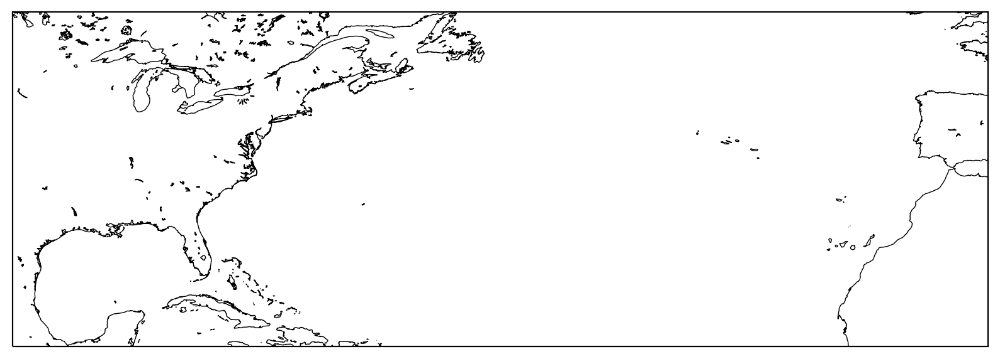

In [217]:
proj=ccrs.PlateCarree(globe=None)
fig, ax = plt.subplots(figsize=(10,5), dpi=200, subplot_kw=dict(projection=proj))

ax.set_extent([260., 358., 18., 40])
ax.add_feature(cfeature.COASTLINE.with_scale('10m'), linewidth=0.5, zorder=1)
ax.add_feature(cfeature.LAKES.with_scale('10m'), linewidth=0.5, facecolor='w', edgecolor='black', zorder=1)
#ax.add_feature(cfeature.STATES, linewidth=0.5)
#ax.add_feature(cfeature.BORDERS, linewidth=0.5)

color_order = ['Tropical Depression', 'Tropical Storm', 'Category 1', 'Category 2', 'Category 3', 'Category 4', 'Category 5']
cat_colors = ['#5EBAFF', '#00FAF4', '#FFF795', '#FFD821', '#FF8F20', '#FF6060', '#C464D9']
marker_style = dict(color='tab:blue', linestyle=':', marker=np.repeat('o', 33),
                    markersize=15)

# sns.scatterplot(x='lon', y='lat', data=te_tracks[0][te_tracks[0]['miami_dist'] <= 500.0], 
#                 hue='ss_wsp', hue_order=color_order, palette=sns.color_palette(cat_colors), transform=proj, ax=ax)
g = sns.lineplot(x='lon', y='lat', data=te_tracks[0][(te_tracks[0].lat>=18) & (te_tracks[0].lat<=60) &\
                                                     (te_tracks[0].lon>=260) & (te_tracks[0].lon<=360) &\
                                                     (te_tracks[0].time.dt.year >= 2012)], 
                 markers=marker_style, hue='ss_wsp', hue_order=color_order, palette=sns.color_palette(cat_colors), 
                 style='tempest_ID', dashes=False, transform=proj, ax=ax, zorder=10)
h,l = g.get_legend_handles_labels()
plt.legend(h[0:8],l[0:13],bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., title='Saffir Simpson Wind Scale')
plt.title('TempestExtremes Spaghetti Plot')
plt.show(g)
#plt.show()

In [ ]:
?plt.legend

In [ ]:
sns.set()

In [27]:
os.path.isdir('../figs/te_plots', te_track_files[0].split('/')[-1]))

True

In [28]:
os.path.join('../figs/te_plots', te_track_files[0].split('/')[-1]+'.png')

'../figs/te_plots/trajectories.txt.CHEY.VR28.NATL.REF.CAM5.4CLM5.0.dtime900.002.png'

In [101]:
def compare_te_tracks(df, file_name, savefig=False):
    proj=ccrs.PlateCarree(globe=None)
    color_order = ['Tropical Depression', 'Tropical Storm', 'Category 1', 'Category 2', 'Category 3', 'Category 4', 'Category 5']
    cat_colors = ['#5EBAFF', '#00FAF4', '#FFF795', '#FFD821', '#FF8F20', '#FF6060', '#C464D9']

    g = sns.FacetGrid(df[df['miami_dist'] <= 500.0], col="tempest_ID", hue='ss_wsp',
                      col_wrap=8, height=3.5, hue_order=color_order, palette=sns.color_palette(cat_colors),
                      subplot_kws=dict(projection=proj))
    #g3.map_dataframe(sns.lineplot, x='lon', y='lat')
    g.map_dataframe(sns.scatterplot, x='lon', y='lat', zorder=10, s=20, edgecolor='black', linewidth=0.5)
    g.map(plt.scatter, x=-80.208615, y=25.775163, marker='*', s=50, zorder=2, facecolor='#00FF00', edgecolor='black', linewidth=0.75)

    title = file_name.split('/')[-1]
    g.fig.suptitle(title, fontsize=16, fontweight='bold')
    g.figure.subplots_adjust(top=.96)
    g.set_titles(size=12)

    for ax in g.axes.ravel():
        #ax.set_extent([270., 290., 20., 32])
        ax.add_feature(cfeature.COASTLINE.with_scale('10m'), linewidth=0.5, zorder=1)
        ax.add_feature(cfeature.LAKES.with_scale('10m'), linewidth=0.5, facecolor='w', edgecolor='black', zorder=1)
    
    if savefig == True:
        plt.savefig(os.path.join('../figs/te_plots', title+'.png'), dpi=300)

In [174]:
def select_te_tracks(df, stracks, file_name, savefig=False):
    df = df[df['tempest_ID'].isin(stracks)]
    proj=ccrs.PlateCarree(globe=None)
    color_order = ['Tropical Depression', 'Tropical Storm', 'Category 1', 'Category 2', 'Category 3', 'Category 4', 'Category 5']
    cat_colors = ['#5EBAFF', '#00FAF4', '#FFF795', '#FFD821', '#FF8F20', '#FF6060', '#C464D9']

    g = sns.FacetGrid(df, col="tempest_ID", hue='ss_wsp', col_wrap=4,
                      height=3.5, hue_order=color_order, palette=sns.color_palette(cat_colors),
                      subplot_kws=dict(projection=proj))
    #g3.map_dataframe(sns.lineplot, x='lon', y='lat')
    g.map_dataframe(sns.scatterplot, x='lon', y='lat', zorder=10, s=20, edgecolor='black', linewidth=0.5)
    g.map(plt.scatter, x=-80.208615, y=25.775163, marker='*', s=50, zorder=2, facecolor='#00FF00', edgecolor='black', linewidth=0.75)

    title = file_name.split('/')[-1]
    g.fig.suptitle(title, fontsize=16, fontweight='bold')
    g.figure.subplots_adjust(top=.8)
    g.set_titles(size=12)

    for ax in g.axes.ravel():
        ax.set_extent([270.5, 286., 19., 32])
        ax.add_feature(cfeature.COASTLINE.with_scale('10m'), linewidth=0.5, zorder=1)
        ax.add_feature(cfeature.LAKES.with_scale('10m'), linewidth=0.5, facecolor='w', edgecolor='black', zorder=1)
    
    if savefig == True:
        plt.savefig(os.path.join('../figs/te_plots', title+'_selected.png'), dpi=300)

[None, None, None, None, None, None, None]

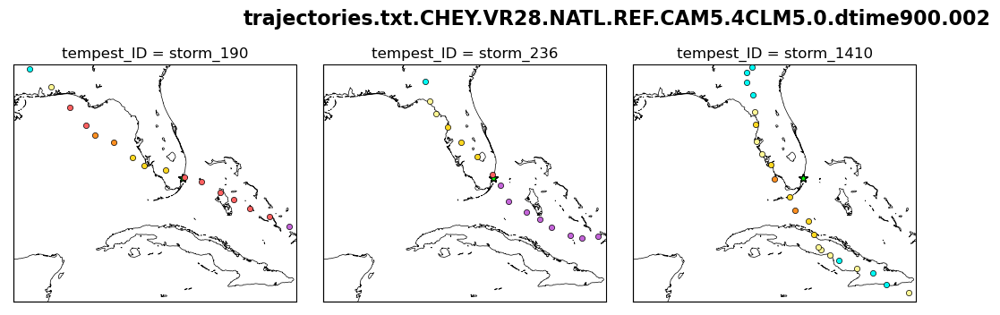

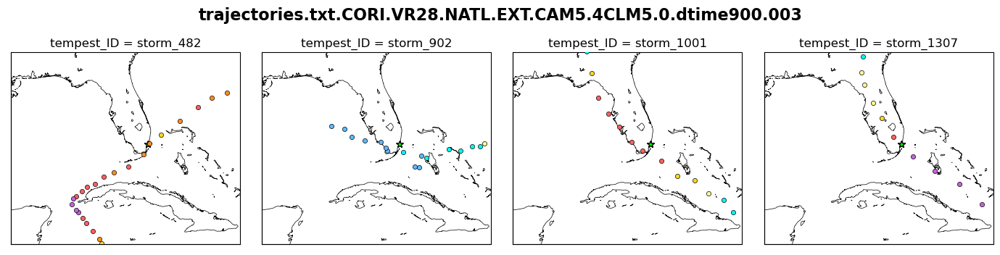

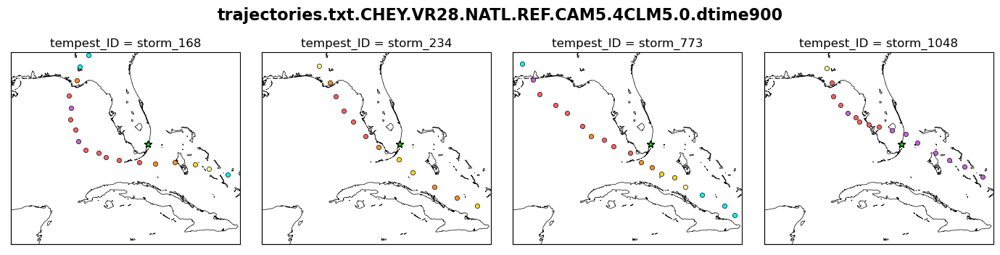

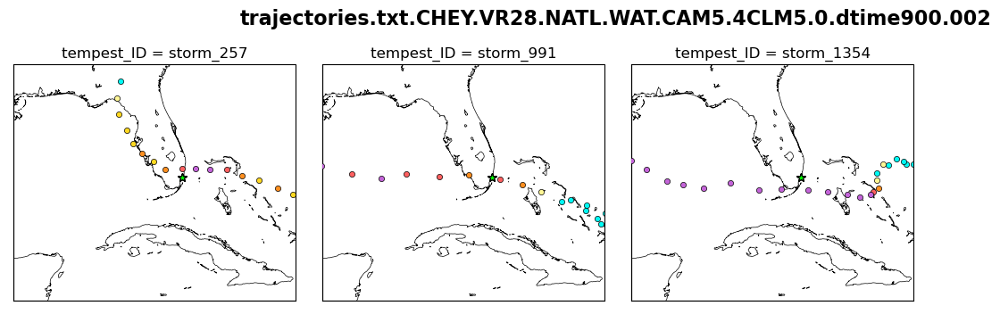

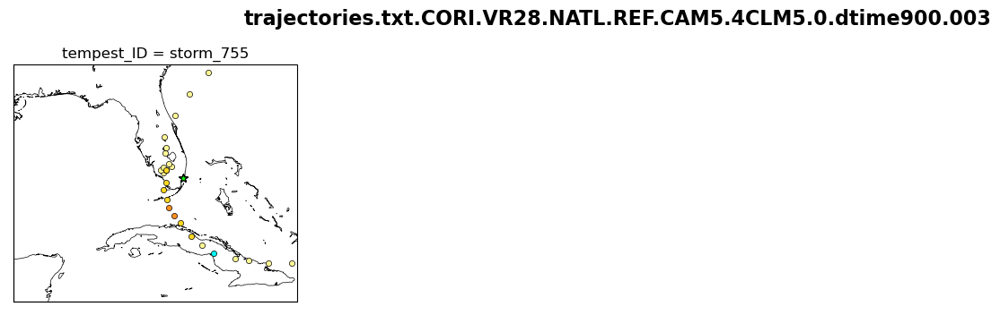

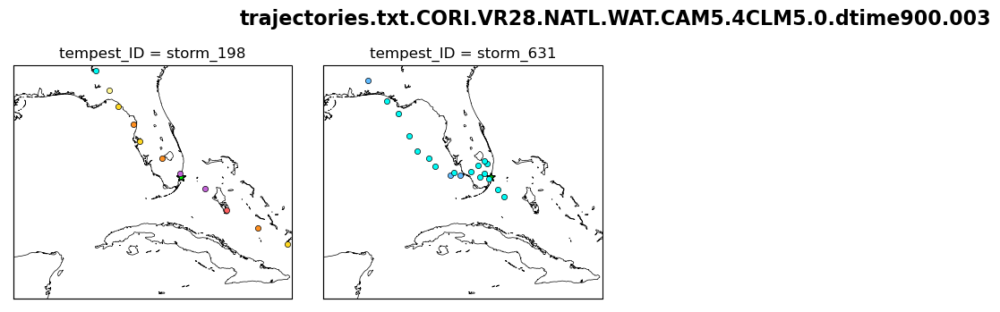

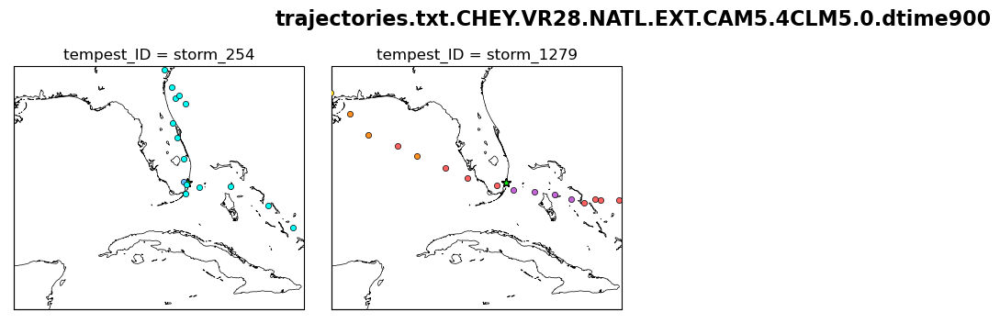

In [177]:
selected_tracks = [['storm_190', 'storm_236', 'storm_1410'],
           ['storm_482', 'storm_902', 'storm_1001', 'storm_1307'], 
           ['storm_168', 'storm_234', 'storm_773', 'storm_1048'], None, 
           ['storm_257', 'storm_991', 'storm_1354'], 
           ['storm_755'], None, 
           ['storm_198', 'storm_631'], 
           ['storm_254', 'storm_1279']]

[select_te_tracks(te_tracks[i], selected_tracks[i], f, savefig=True) for i, 
 f in enumerate(te_track_files) if selected_tracks[i] != None]

In [ ]:
[compare_te_tracks(te_tracks[i], f, savefig=True) for i, f in enumerate(te_track_files)]

'\nSelected tracks:\nstorm_190 (has cat 4 hit directly on Miami)\n'

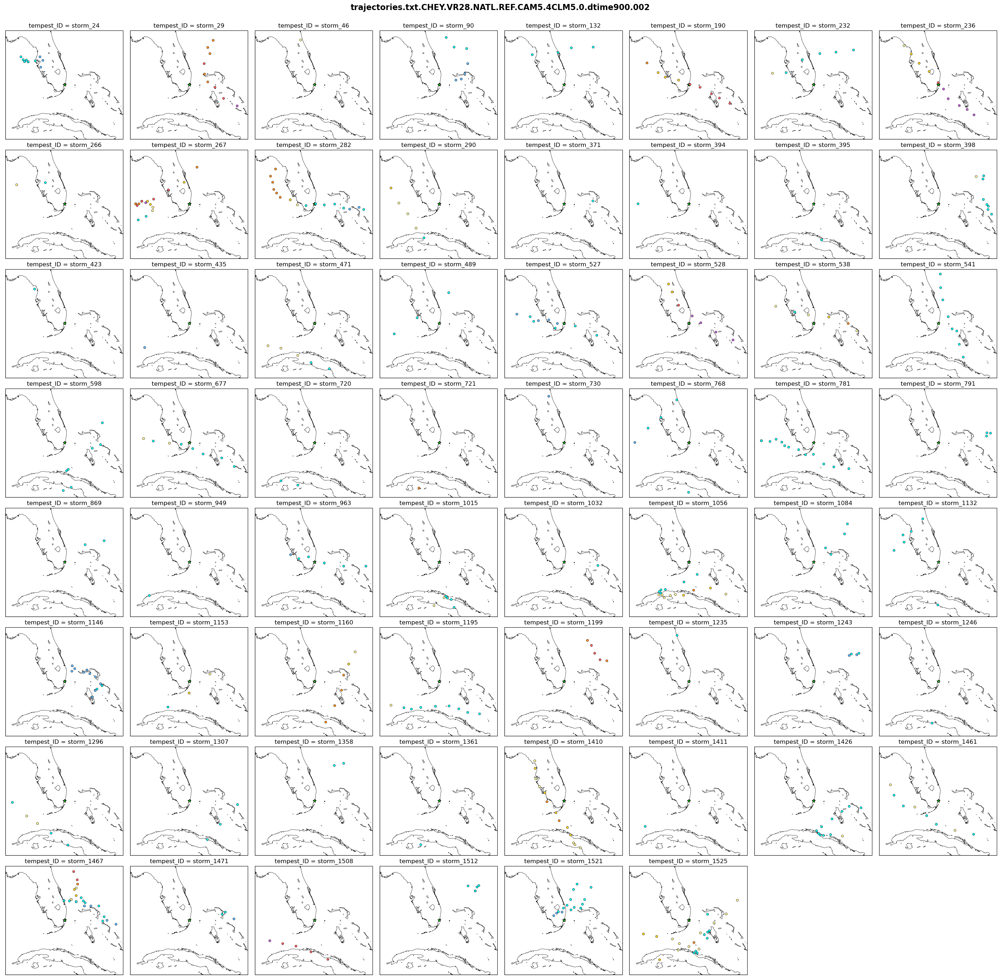

In [91]:
compare_te_tracks(te_tracks[0], te_track_files[0])

"""
Selected tracks - tracks[0]:
storm_190 - has cat 4 hit directly on Miami
storm_236 - has cat 4 (high end?) hit directly on Ft. Lauderdale?
storm_1410 - has cat 3 Keys landfall and follows west coast up (storm surge risk to Miami)

Selected tracks - tracks[1]:
storm_482 - has cat 3 second landfall on Miami, comes up the coast weird (SW-NE, surge risk)
storm_902 - weak TS/TD hangs around Miami for ~24 hours (flood risk)
storm_1001 - cat 4 Everglades landfall (surge risk, brown ocean effect)
storm_1307 - direct Miami landfall, very normal track (temporally and spatially) curved up center of Florida, cat 4-5 landfall

Selected tracks - tracks[2]:
storm_168 - cat 4 south keys landfall (somewhat surge risk)
storm_234 - cat 3 keys landfall (same as tracks[0][storm_1410])
storm_773 - same as storm_234 but further away
storm_1408 - cat 5 landfall West Palm Beach (~1 hour north of Miami)

Selected tracks - tracks[3]: none

Selected tracks - tracks[4]:
storm_257 - same as (tracks[0][storm_236])
storm_991 - cat 4 direct landfall, very normal track across Florida into Gulf
storm_1048 - cat 5 direct landfall Key Largo, 2nd landfall in Everglades (huge surge risk, brown ocean effect)

Selected tracks - tracks[5]:
storm_755 - meanders as a cat 2-3 over Cypress Nat'l Forest for ~48 hours (flood/inundation risk depending on size)

tracks[6]: none

tracks[7]:
storm_198 - cat 5 landfall in Ft. Lauderdale?
storm_631 - meandering TS across S. Florida for ~54 hours

tracks[8]:
storm_254 - TS/TD meandering across Miami for ~24 hours
storm_1279 - cat 4/5 landfall just south of Miami (huge surge risk, right front quadrant risk, tornadic risk)


"""

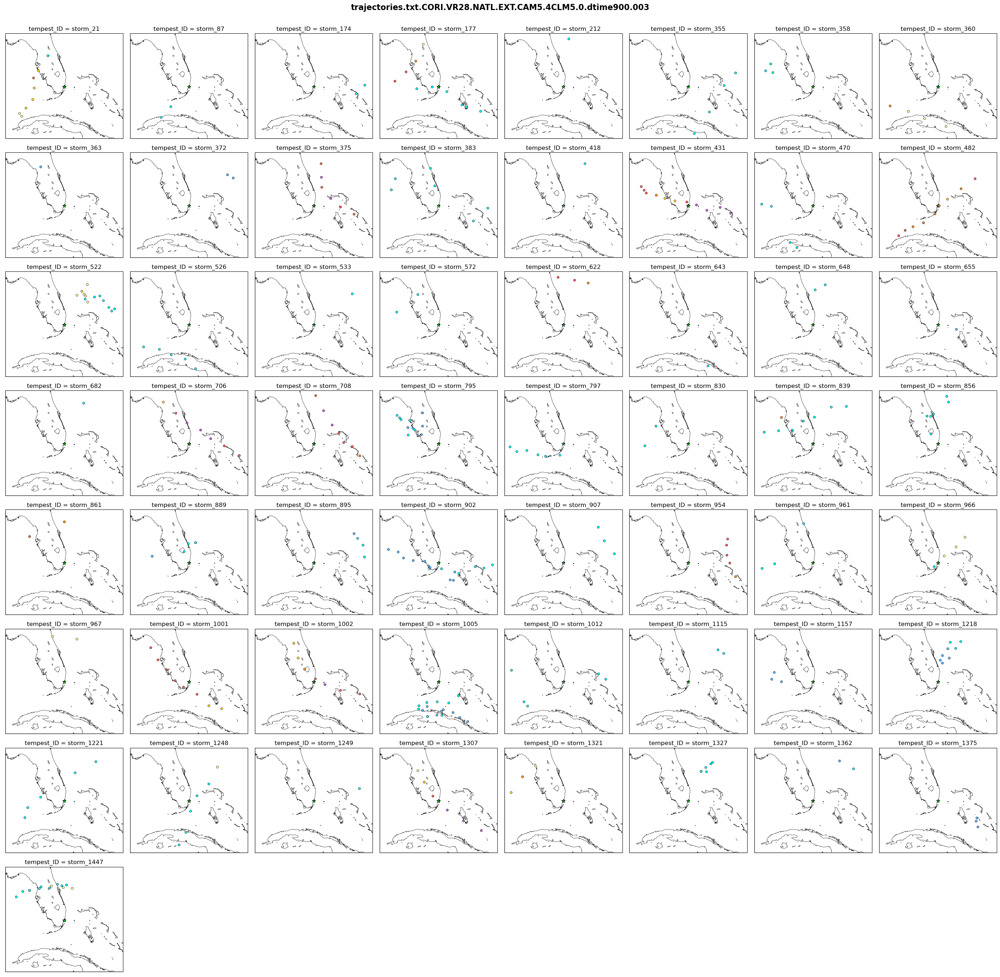

In [99]:
compare_te_tracks(te_tracks[1], te_track_files[1])

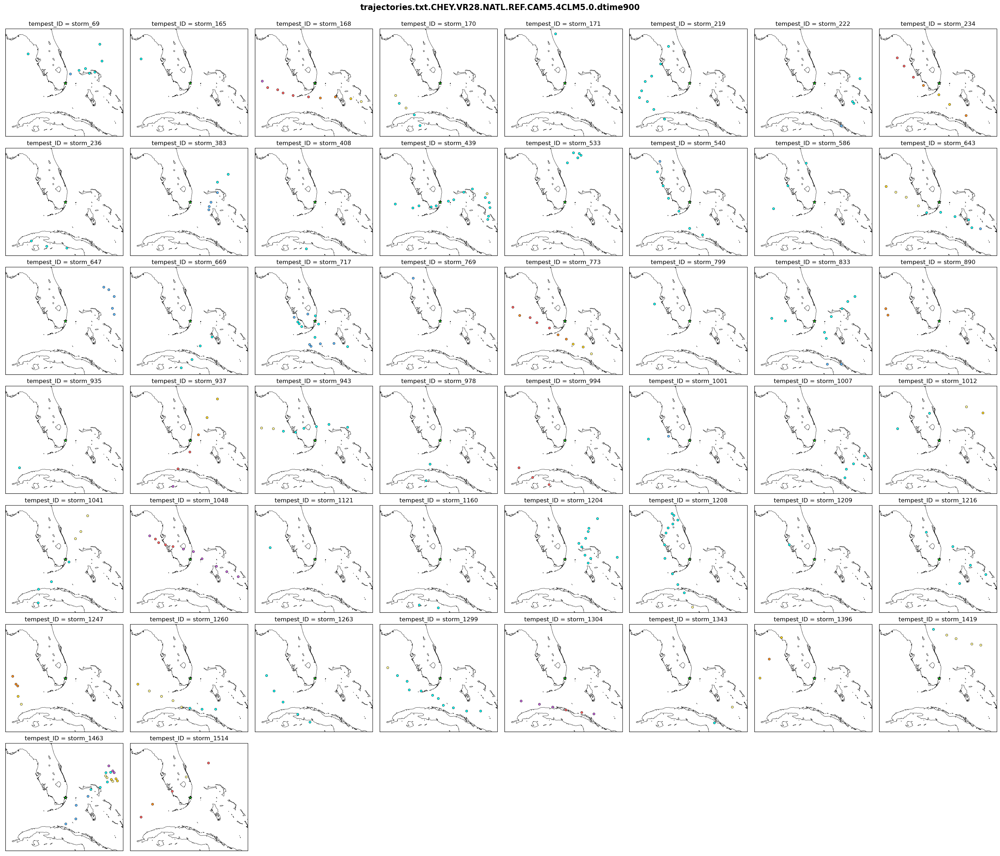

In [98]:
compare_te_tracks(te_tracks[2], te_track_files[2])

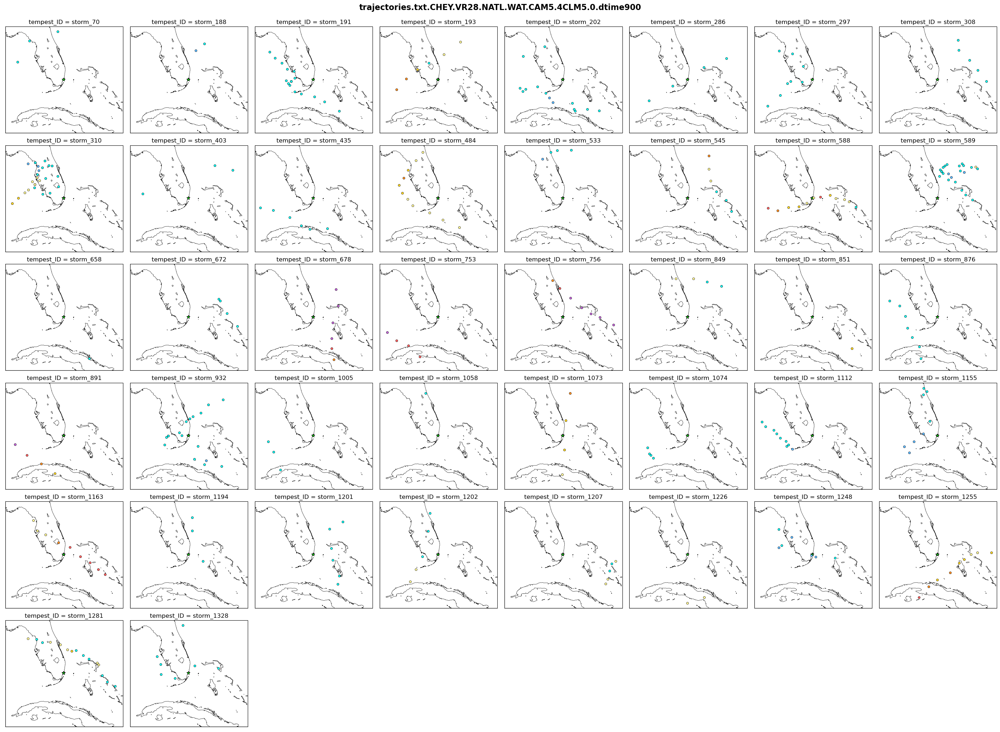

In [97]:
compare_te_tracks(te_tracks[3], te_track_files[3])

In [96]:
compare_te_tracks(te_tracks[4], te_track_files[4])

Error in callback <function flush_figures at 0x17b344310> (for post_execute):


KeyboardInterrupt: 

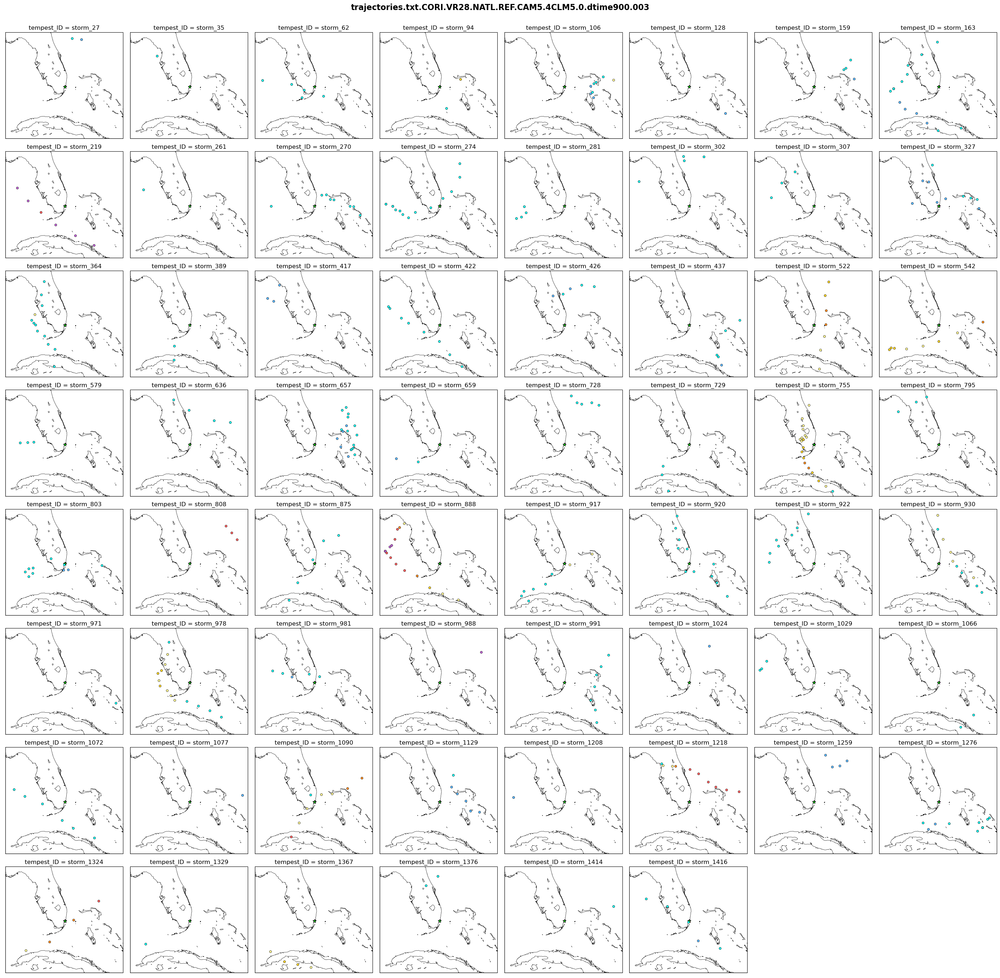

In [95]:
compare_te_tracks(te_tracks[5], te_track_files[5])

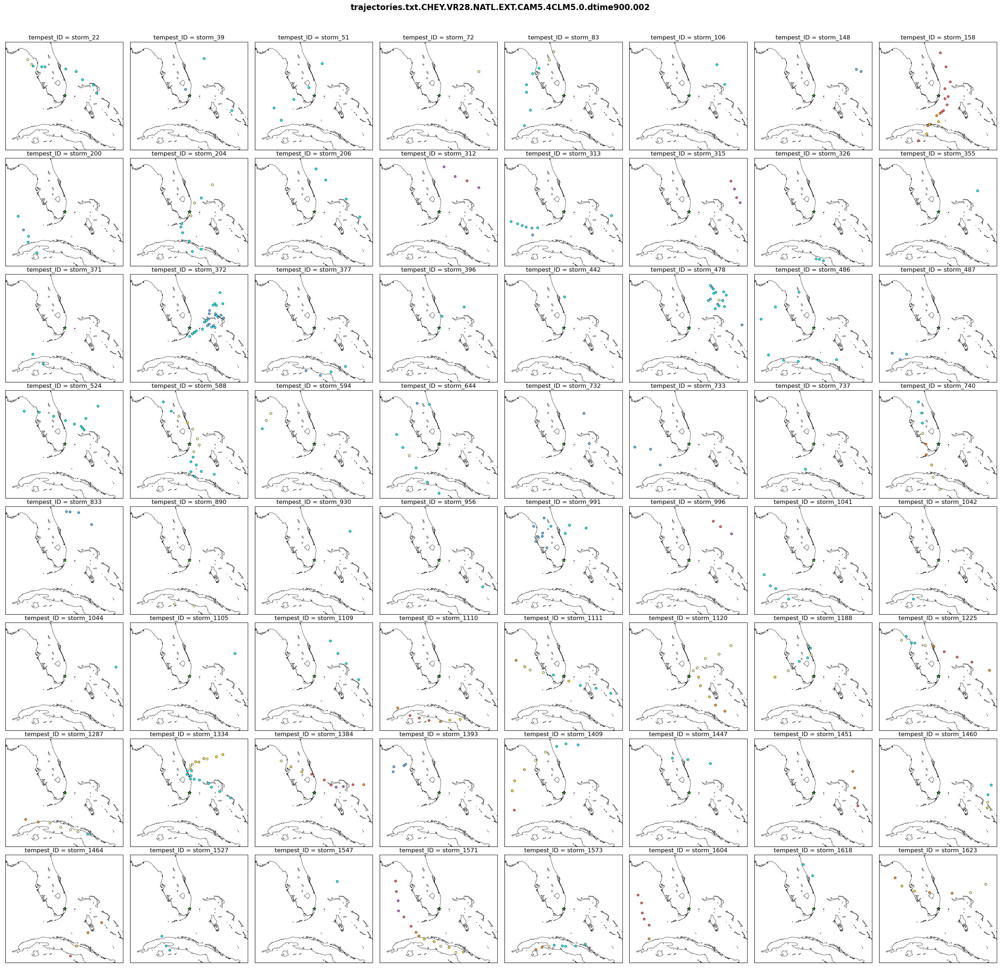

In [94]:
compare_te_tracks(te_tracks[6], te_track_files[6])

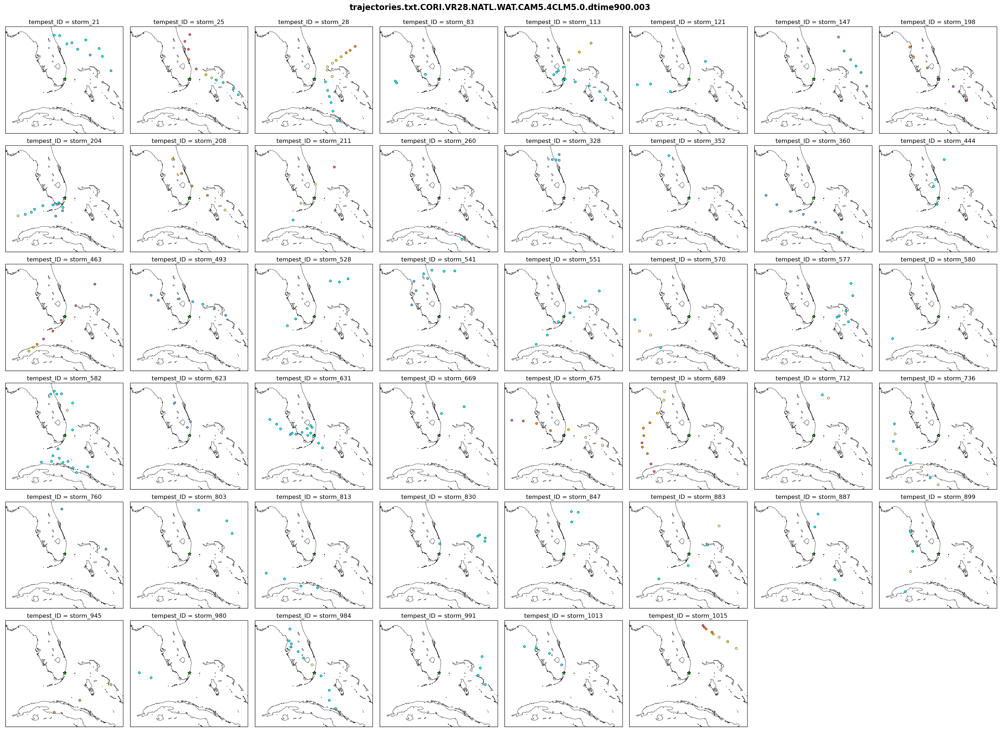

In [93]:
compare_te_tracks(te_tracks[7], te_track_files[7])

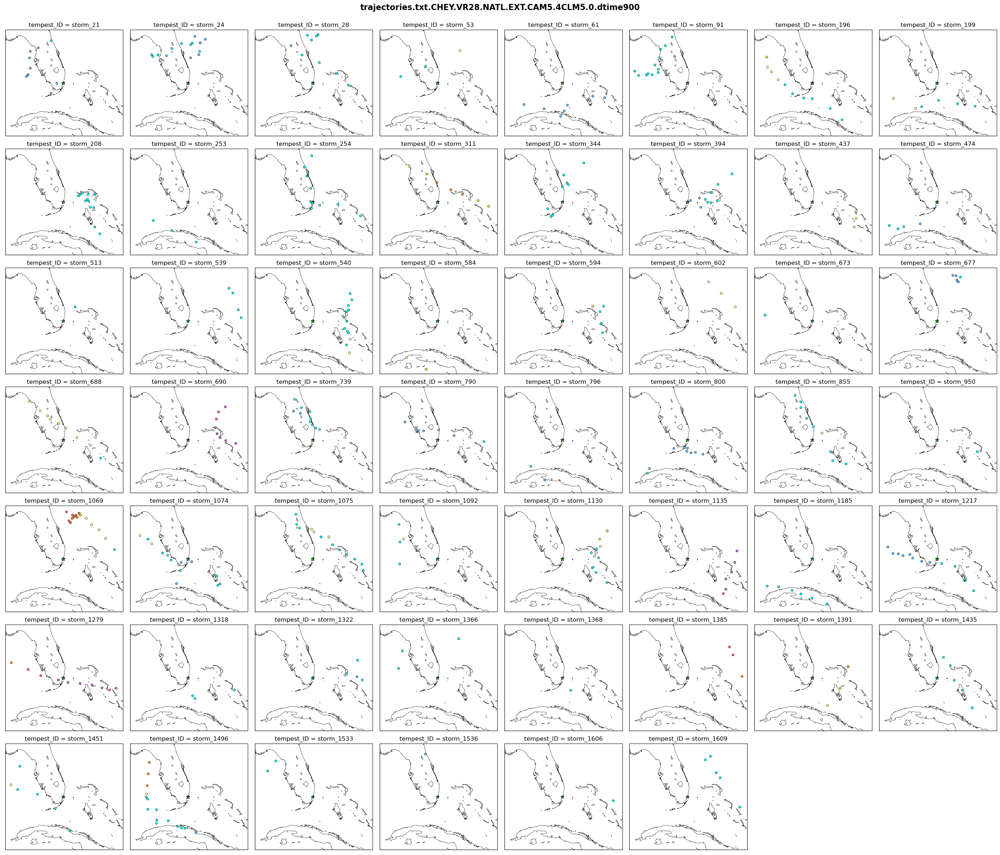

In [92]:
compare_te_tracks(te_tracks[8], te_track_files[8])

In [124]:
# block to calculate translation speed (needs to be first before dropping due to miami_dist)
test_df = te_track_dfs[0].copy()
test_df['tempest_ID'].unique()
#[test_df[test_df == storm].apply(lambda x: haversine_vector((x.lat, x.lon), (x.lat, *x.lon), unit='mi', 
                                                                 normalize=True)[0], axis=1).round(4) for storm in test_df['tempest_ID'].unique()]

array(['storm_0', 'storm_1', 'storm_2', ..., 'storm_1528', 'storm_1529',
       'storm_1530'], dtype=object)

In [ ]:
# block to calculate translation speed (needs to be first before dropping due to miami_dist)
test_df['t_speed'] = test_df.rolling(2, on='tempest_ID', closed='both').apply(lambda x: haversine_vector(x.lat)

In [112]:
test_df.groupby(['tempest_ID'])['lon'].shift(1)

0               NaN
1         83.116714
2         82.070597
3         82.070597
4         80.359140
            ...    
38858    118.239365
38859    119.008239
38860    119.814654
38861    121.385520
38862    123.473148
Name: lon, Length: 38863, dtype: float64

In [87]:
#test_df['ts1'] = test_df.groupby('tempest_ID', as_index=False)
test_df.groupby('tempest_ID').lon

tempest_ID
storm_0       [nan, nan]
storm_1       [nan, nan]
storm_10      [nan, nan]
storm_100     [nan, nan]
storm_1000    [nan, nan]
                 ...    
storm_995     [nan, nan]
storm_996     [nan, nan]
storm_997     [nan, nan]
storm_998     [nan, nan]
storm_999     [nan, nan]
Length: 1531, dtype: object

In [97]:
test_df

,time,lon,lat,slp,wsp,sfc_phi,tempest_ID,t_speed
0,1985-01-25 00:00:00,83.116714,7.634498,98708.27,32.26449,0.000,storm_0,NaN
1,1985-01-25 06:00:00,82.070597,7.592107,99701.32,27.35374,0.000,storm_0,NaN
2,1985-01-25 12:00:00,82.070597,7.592107,99822.81,24.49513,0.000,storm_0,NaN
3,1985-01-25 18:00:00,80.359140,7.493154,100234.10,18.41094,1473.759,storm_0,NaN
4,1985-01-26 00:00:00,79.980944,6.945498,100137.90,16.64115,350.854,storm_0,NaN
...,...,...,...,...,...,...,...,...
38858,2014-12-06 00:00:00,119.008239,-22.209494,99071.34,15.27198,4827.211,storm_1530,NaN
38859,2014-12-06 06:00:00,119.814654,-23.600902,99427.77,14.23425,5750.282,storm_1530,NaN
38860,2014-12-06 12:00:00,121.385520,-24.424525,99674.34,11.88024,5445.413,storm_1530,NaN
38861,2014-12-06 18:00:00,123.473148,-25.477910,99659.17,12.88766,5186.333,storm_1530,NaN


In [72]:
test_df['t_speed'] = test_df.apply(lambda x: haversine_vector((x.lat, x.lon), (*x.lat, *x.lon), unit='mi', 
                                                                 normalize=True)[0], axis=1).round(4)
test_df

TypeError: Value after * must be an iterable, not float

In [78]:

test_df['t_speed'] = test_df.groupby('tempest_ID').\
apply(lambda x: haversine_vector([x.lat, x.lon], 
                                 [x.lat.shift().rolling(1), x.lon.shift().rolling(1)], unit='mi')).reset_index(drop=True)

IndexError: When not in combination mode, arrays must be of same size. If mode is required, use comb=True as argument.

In [125]:
test_df = te_track_dfs[0].copy()
# block to calculate distance from miami
miami_coords = (25.775163, -80.208615)
miami_dist = 500.0 #km
test_df['miami_dist'] = test_df.apply(lambda x: haversine_vector((x.lat, x.lon), 
                                                                 miami_coords, unit='km', 
                                                                 normalize=True)[0], axis=1).round(4)
#test_df = test_df[test_df['miami_dist'].apply(lambda x: x <= miami_dist)].reset_index(drop=True)
test_df

,time,lon,lat,slp,wsp,sfc_phi,tempest_ID,miami_dist
0,1985-06-19 12:00:00,277.813118,27.990064,101544.80,13.90945,292.2202,storm_24,314.8695
1,1985-06-20 06:00:00,277.600276,27.381539,101545.40,13.66295,117.8023,storm_24,281.7383
2,1985-06-20 12:00:00,277.542548,28.308044,101422.50,11.70446,227.1171,storm_24,359.0443
3,1985-06-20 18:00:00,276.471536,27.856894,101262.40,14.82899,0.0000,storm_24,402.6086
4,1985-06-21 00:00:00,277.114503,27.955450,100875.60,19.05283,0.0000,storm_24,359.5338
...,...,...,...,...,...,...,...,...
384,2014-11-10 12:00:00,280.822373,24.637302,97600.48,41.58885,0.0000,storm_1525,163.6052
385,2014-11-10 18:00:00,281.473588,24.714577,98524.67,32.90224,0.0000,storm_1525,206.2299
386,2014-11-11 00:00:00,282.061084,25.571008,98525.06,36.66492,0.0000,storm_1525,228.5916
387,2014-11-11 06:00:00,283.144112,26.367210,98478.59,34.71471,0.0000,storm_1525,341.2713


In [126]:
# block to calculate saffir-simpson
test_df['ss_wsp'] = test_df.apply(lambda x: saffir_simpson(x.wsp, 'm/s'), axis=1)
test_df

,time,lon,lat,slp,wsp,sfc_phi,tempest_ID,miami_dist,ss_wsp
0,1985-06-19 12:00:00,277.813118,27.990064,101544.80,13.90945,292.2202,storm_24,314.8695,Tropical Storm
1,1985-06-20 06:00:00,277.600276,27.381539,101545.40,13.66295,117.8023,storm_24,281.7383,Tropical Storm
2,1985-06-20 12:00:00,277.542548,28.308044,101422.50,11.70446,227.1171,storm_24,359.0443,Tropical Storm
3,1985-06-20 18:00:00,276.471536,27.856894,101262.40,14.82899,0.0000,storm_24,402.6086,Tropical Storm
4,1985-06-21 00:00:00,277.114503,27.955450,100875.60,19.05283,0.0000,storm_24,359.5338,Tropical Storm
...,...,...,...,...,...,...,...,...,...
384,2014-11-10 12:00:00,280.822373,24.637302,97600.48,41.58885,0.0000,storm_1525,163.6052,Category 1
385,2014-11-10 18:00:00,281.473588,24.714577,98524.67,32.90224,0.0000,storm_1525,206.2299,Tropical Storm
386,2014-11-11 00:00:00,282.061084,25.571008,98525.06,36.66492,0.0000,storm_1525,228.5916,Category 1
387,2014-11-11 06:00:00,283.144112,26.367210,98478.59,34.71471,0.0000,storm_1525,341.2713,Category 1


In [127]:
# List of storm ID's for cat 5's to check
test_df[test_df['ss_wsp'] == 'Category 5'].tempest_ID.unique()

array(['storm_29', 'storm_236', 'storm_267', 'storm_528', 'storm_1508'],
      dtype=object)

In [128]:
test_df[test_df['ss_wsp'] == 'Category 5']

,time,lon,lat,slp,wsp,sfc_phi,tempest_ID,miami_dist,ss_wsp
11,1985-09-15 12:00:00,284.089607,23.862352,95613.16,73.38383,0.0,storm_29,483.0902,Category 5
47,1989-08-23 00:00:00,283.001847,23.078309,90256.03,87.13704,0.0,storm_236,442.1955,Category 5
48,1989-08-23 06:00:00,282.381006,23.540762,90592.90,80.42468,0.0,storm_236,360.8298,Category 5
49,1989-08-23 12:00:00,281.651814,23.920807,91601.78,76.31871,0.0,storm_236,278.8361,Category 5
50,1989-08-23 18:00:00,280.652663,24.507471,90759.94,73.80475,0.0,storm_236,165.4867,Category 5
51,1989-08-24 00:00:00,280.231895,25.383040,90553.23,74.92215,0.0,storm_236,62.0738,Category 5
71,1990-06-02 18:00:00,275.843736,25.913134,93537.96,72.30181,0.0,storm_267,395.3386,Category 5
127,1995-08-07 06:00:00,283.763141,24.292746,93764.52,82.93830,0.0,storm_528,432.7422,Category 5
128,1995-08-07 12:00:00,282.222186,25.016947,92161.77,83.46978,0.0,storm_528,258.3131,Category 5
129,1995-08-07 18:00:00,280.845604,25.854517,92016.97,77.54966,0.0,storm_528,105.8937,Category 5


In [ ]:
# block to calculate translation speed
